<a href="https://colab.research.google.com/github/huythong267/WideResnet_Tensorflow_Keras/blob/main/Wide_Resnet_Tensorflow_Keras.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt

from sklearn import metrics

from tensorflow.keras.regularizers import l2

Wide Resnet

This notebook is an implemenation of the Wide-Resnet architecture presented in [WideResnet Paper](https://arxiv.org/pdf/1605.07146v1.pdf)





## Config

In [2]:
class Config:
    def __init__(self,):
        self.n_classes = 10

        self.wide_resnet_n = 28
        self.wide_resnet_k = 2
        self.activation_fn = lambda: tf.keras.layers.ReLU()
        self.normalization_fn = lambda: tf.keras.layers.BatchNormalization(axis=-1)
        self.dropout_rate = 0.2
        self.weight_decay = 0.0005
        self.weight_init = 'he_normal'

        self.lr = 0.1
        self.momentum = 0.9
        
        self.batch_size = 100
        self.n_epochs = 200

        self.log_dir = 'logs/fit'
        self.writer = tf.summary.create_file_writer(self.log_dir)
        self.writer.set_as_default()

config = Config()

## WideResnet

### Blocks

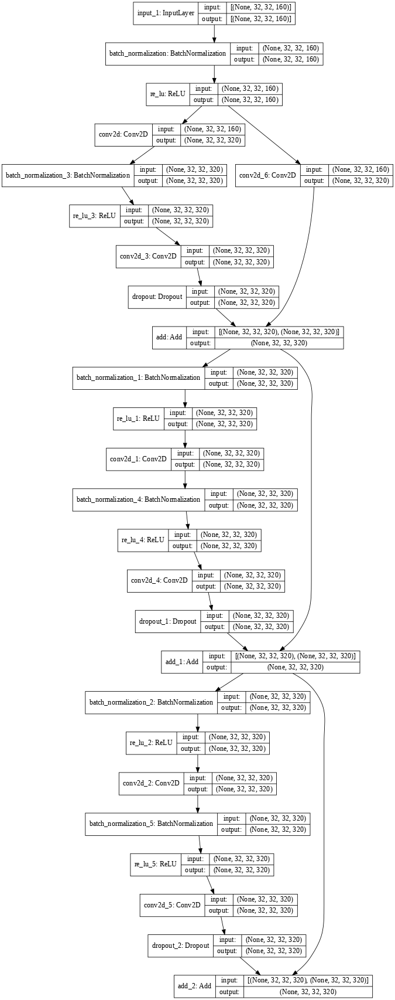

In [3]:
class WideResNetBlock(tf.keras.layers.Layer):
    def __init__(self, 
                 input_filters, 
                 output_filters, 
                 n_blocks, 
                 stride=2, 
                 dropout_rate=config.dropout_rate,
                 activation_fn=config.activation_fn, 
                 normalization_fn=config.normalization_fn,
                 weight_init=config.weight_init,
                 weight_decay=config.weight_decay):
        super().__init__()
        self.input_filters = input_filters
        self.output_filters = output_filters
        self.n_blocks = n_blocks
        self.stride = stride

        self.relu1 = [activation_fn() for _ in range(self.n_blocks)]
        self.relu2 = [activation_fn() for _ in range(self.n_blocks)]

        self.bn1 = [normalization_fn() for _ in range(self.n_blocks)]
        self.bn2 = [normalization_fn() for _ in range(self.n_blocks)]

        stride_fnc = lambda idx: stride if idx == 0 else 1
        self.conv1 = [tf.keras.layers.Conv2D(
            filters=output_filters, 
            kernel_size=3, 
            strides=stride_fnc(idx),
            padding='same',
            kernel_initializer=weight_init,
            kernel_regularizer=l2(weight_decay),
        ) for idx in range(self.n_blocks)]

        self.conv2 = [tf.keras.layers.Conv2D(
            filters=output_filters, 
            kernel_size=3, 
            strides=1,
            padding='same',
            kernel_initializer=weight_init,
            kernel_regularizer=l2(weight_decay),
        ) for _ in range(self.n_blocks)]
        
        self.dropout = [tf.keras.layers.Dropout(rate=dropout_rate) 
                                    for _ in range(self.n_blocks)]

        self.downsample = tf.keras.layers.Conv2D(
            filters=output_filters, 
            kernel_size=1, 
            strides=stride,
        )

    def call(self, x, training=False):
        x = self.wide_resnet_step(x, 0, pre_res_act=True, training=training)
        for idx in range(1, self.n_blocks):
            x = self.wide_resnet_step(x, idx, training=training)
        return x

    def wide_resnet_step(self, x0, idx, pre_res_act=False, training=False):
        act = self.relu1[idx](self.bn1[idx](x0))
        x = self.conv1[idx](act)
        x = self.relu2[idx](self.bn2[idx](x))
        x = self.conv2[idx](x)
        x = self.dropout[idx](x, training=training)

        short_cut = self.downsample(act) if pre_res_act else x0
        return tf.keras.layers.Add()([x, short_cut])

    # Helper to visualize the shape inside the model
    def as_model(self, width, height, name='wide_resnet'):
        x0 = tf.keras.layers.Input(shape=(width, height, self.input_filters))
        return tf.keras.Model(inputs=x0, outputs = self.call(x0), name=name)


layer = WideResNetBlock(input_filters=160, output_filters=320, n_blocks=3, stride=1)
tf.keras.utils.plot_model(layer.as_model(32, 32), show_shapes=True, 
                          dpi=60, expand_nested=True)

### Full Models

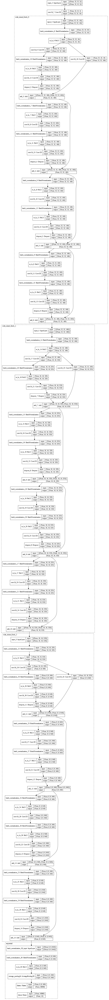

In [4]:
class WideResNet(tf.keras.Model):
    def __init__(self, n_classes=10, n=16, k=2,
                 activation_fn=config.activation_fn, 
                 normalization_fn=config.normalization_fn,
                 weight_init=config.weight_init,
                 weight_decay=config.weight_decay):
        super().__init__()
        
        self.n_classes, self.n, self.k = n_classes, n, k
        assert (n - 4) % 6 == 0
        n_blocks = (n - 4) // 6
        n_layers = [16, self.k * 16, self.k * 32, self.k * 64]

        self.conv1 = tf.keras.layers.Conv2D(
            filters=n_layers[0], 
            kernel_size=3, 
            padding='same',
            kernel_initializer=weight_init,
            kernel_regularizer=l2(weight_decay),
        )

        self.wide_resnet_block = [WideResNetBlock(
            input_filters=n_layers[idx-1], 
            output_filters=n_layers[idx], 
            n_blocks=n_blocks, 
            stride = 1 if idx == 1 else 2,
            activation_fn=activation_fn, 
            normalization_fn=normalization_fn,
            weight_init=weight_init,
            weight_decay=weight_decay,
            )
            for idx in [1, 2, 3]]

        self.classifier = tf.keras.Sequential([
            normalization_fn(),
            activation_fn(),
            tf.keras.layers.AveragePooling2D(
                pool_size=(8, 8), 
                strides=(1, 1), 
                padding='same'),
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(
                self.n_classes,
                kernel_initializer=weight_init,
                kernel_regularizer=l2(weight_decay)),
        ])

    def call(self, x, training=False):
        x = self.conv1(x)
        x = self.wide_resnet_block[0](x, training=training)
        x = self.wide_resnet_block[1](x, training=training)
        x = self.wide_resnet_block[2](x, training=training)
        return self.classifier(x)

    # Helper to visualize the shape inside the model
    def view_model(self, image_shape=(32, 32, 3), expand_nested=True):
        x0 = tf.keras.layers.Input(shape=image_shape)
        if not expand_nested:
            return tf.keras.Model(inputs=x0, outputs = self.call(x0))
        
        else:
            # Helper to set shapes for layers and plot models
            width, height = image_shape[:2]
            def wide_resnet_layers_to_models(idx):
                w = width if idx != 2 else width//2
                h = height if idx != 2 else height//2
                name = 'wide_resnet_block_%s' %idx
                return self.wide_resnet_block[idx].as_model(w, h, name)

            x = self.conv1(x0)
            x = wide_resnet_layers_to_models(0)(x)
            x = wide_resnet_layers_to_models(1)(x)
            x = wide_resnet_layers_to_models(2)(x)
            x = self.classifier(x)

            return tf.keras.Model(inputs=x0, outputs = x)

wide_resnet = WideResNet(n=28, k=10)
tf.keras.utils.plot_model(wide_resnet.view_model(
                                image_shape=(32, 32, 3), 
                            ), show_shapes=True, dpi=60, expand_nested=True)

## Training

Show an example of training the WideResnet on the CIFAR10 dataset

In [19]:
%load_ext tensorboard
%tensorboard --logdir {config.log_dir}

Reusing TensorBoard on port 6006 (pid 115), started 1:53:20 ago. (Use '!kill 115' to kill it.)

<IPython.core.display.Javascript object>

### Examples of CIFAR-10

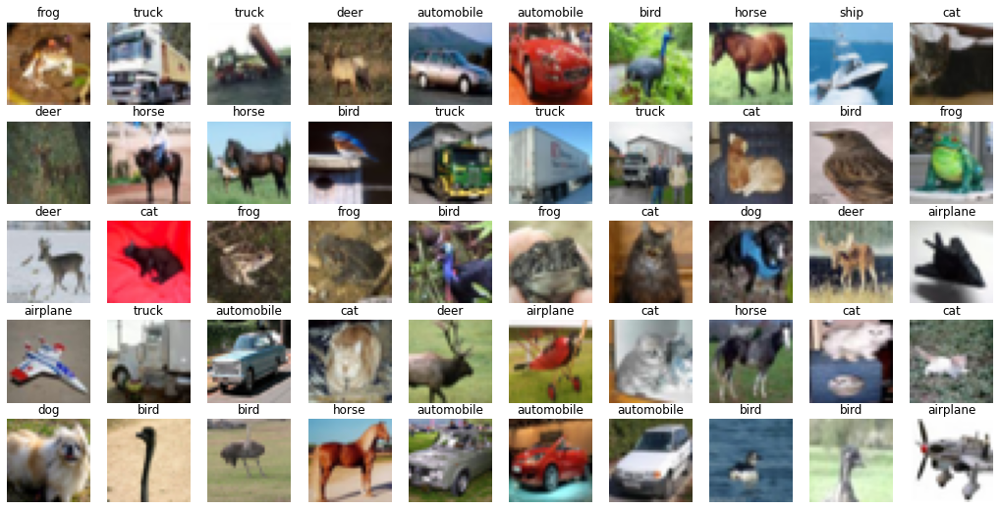

In [9]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.cifar10.load_data()

n_rows, n_cols = 5, 10
label_map = {0: 'airplane', 1: 'automobile', 2: 'bird', 3: 'cat', 4: 'deer', 
             5: 'dog', 6: 'frog', 7: 'horse', 8: 'ship', 9: 'truck'}

ds = tf.data.Dataset.from_tensor_slices((X_train, y_train)).batch(n_cols)

plt.figure(figsize=(1.8 * n_cols, 1.8 * n_rows))
for r, (img, y) in enumerate(ds.take(n_rows)):
    for idx in range(n_cols):
        plt.subplot(n_rows, n_cols, r * n_cols + idx + 1); 
        class_ = label_map[y.numpy().flatten()[idx]]
        plt.imshow(img[idx]); plt.title(class_); plt.axis('off');

In [10]:
cifar10 = tf.keras.datasets.cifar10.load_data()
(trainX, trainY), (testX, testY) = cifar10

trainX = trainX.astype('float32', copy=False)
trainX = (trainX - trainX.mean(axis=0)) / (trainX.std(axis=0))
testX = testX.astype('float32', copy=False)
testX = (testX - testX.mean(axis=0)) / (testX.std(axis=0))

trainY = tf.keras.utils.to_categorical(trainY)
testY = tf.keras.utils.to_categorical(testY)

batch_size = 100
nb_epoch = 200
img_rows, img_cols = 32, 32

generator = tf.keras.preprocessing.image.ImageDataGenerator(rotation_range=10,
                                                    width_shift_range=5./32,
                                                    height_shift_range=5./32,)

### Learning Rate Scheduler

Follows the lr schedule of the paper

In [11]:
lr_schedule = [60, 120, 160] # epoch_step
def schedule(epoch_idx):
    if (epoch_idx + 1) < lr_schedule[0]:
        return 0.1
    elif (epoch_idx + 1) < lr_schedule[1]:
        return 0.02 # lr_decay_ratio = 0.2
    elif (epoch_idx + 1) < lr_schedule[2]:
        return 0.004
    return 0.0008

def get_lr_callbacks():
    return tf.keras.callbacks.LearningRateScheduler(schedule=schedule)

def get_optimizer():
    return tf.keras.optimizers.SGD(lr=0.1, momentum=0.9, nesterov=True)

### CIFAR10 Trainer

####  28 - 2

In [12]:
wide_resnet = WideResNet(n=28, k=2)
wide_resnet.build(tf.TensorShape((None, 32, 32, 3)))
wide_resnet.summary()


loss = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
optimizer = get_optimizer()
wide_resnet.compile(optimizer=optimizer, loss=loss, metrics=["acc"])

Model: "wide_res_net_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_35 (Conv2D)           multiple                  448       
_________________________________________________________________
wide_res_net_block_4 (WideRe multiple                  70880     
_________________________________________________________________
wide_res_net_block_5 (WideRe multiple                  281024    
_________________________________________________________________
wide_res_net_block_6 (WideRe multiple                  1119104   
_________________________________________________________________
sequential_1 (Sequential)    (None, 10)                82442     
Total params: 1,553,898
Trainable params: 1,550,282
Non-trainable params: 3,616
_________________________________________________________________


In [13]:
tensorboard_cb = tf.keras.callbacks.TensorBoard(
    log_dir=config.log_dir, histogram_freq=1, update_freq=5
)
lr_callbacks = get_lr_callbacks()

wide_resnet.fit(generator.flow(trainX, trainY, batch_size=config.batch_size), 
                    steps_per_epoch=len(trainX) // config.batch_size, 
                    epochs=config.n_epochs,
                    callbacks=[tensorboard_cb, lr_callbacks],
                    validation_data=(testX, testY),
                    validation_steps=testX.shape[0] // config.batch_size)

Epoch 1/200
500/500 [==============================] - 38s 64ms/step - loss: 5.7859 - acc: 0.1099 - val_loss: 3.6081 - val_acc: 0.1486
Epoch 2/200
500/500 [==============================] - 31s 63ms/step - loss: 3.1332 - acc: 0.2303 - val_loss: 2.3839 - val_acc: 0.2692
Epoch 3/200
500/500 [==============================] - 31s 62ms/step - loss: 2.2374 - acc: 0.3128 - val_loss: 2.5709 - val_acc: 0.2292
Epoch 4/200
500/500 [==============================] - 31s 63ms/step - loss: 1.8003 - acc: 0.4185 - val_loss: 2.6726 - val_acc: 0.3129
Epoch 5/200
500/500 [==============================] - 31s 63ms/step - loss: 1.5049 - acc: 0.5262 - val_loss: 1.3974 - val_acc: 0.6016
Epoch 6/200
500/500 [==============================] - 31s 63ms/step - loss: 1.3111 - acc: 0.6148 - val_loss: 1.5499 - val_acc: 0.5796
Epoch 7/200
500/500 [==============================] - 32s 63ms/step - loss: 1.1728 - acc: 0.6818 - val_loss: 1.3964 - val_acc: 0.6214
Epoch 8/200
500/500 [==============================] - 

#### 28-10

In [27]:
wide_resnet = WideResNet(n=28, k=10)
wide_resnet.build(tf.TensorShape((None, 32, 32, 3)))
wide_resnet.summary()

loss = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
optimizer = get_optimizer()
wide_resnet.compile(optimizer=optimizer, loss=loss, metrics=["acc"])

Model: "wide_res_net_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_135 (Conv2D)          multiple                  448       
_________________________________________________________________
wide_res_net_block_16 (WideR multiple                  1644384   
_________________________________________________________________
wide_res_net_block_17 (WideR multiple                  6975680   
_________________________________________________________________
wide_res_net_block_18 (WideR multiple                  27877760  
_________________________________________________________________
sequential_5 (Sequential)    (None, 10)                412170    
Total params: 36,910,442
Trainable params: 36,892,490
Non-trainable params: 17,952
_________________________________________________________________


In [28]:
tensorboard_cb = tf.keras.callbacks.TensorBoard(
    log_dir=config.log_dir, histogram_freq=1, update_freq=5
)
lr_callbacks = get_lr_callbacks()

wide_resnet.fit(generator.flow(trainX, trainY, batch_size=config.batch_size), 
                    steps_per_epoch=len(trainX) // config.batch_size, 
                    epochs=config.n_epochs,
                    callbacks=[tensorboard_cb, lr_callbacks],
                    validation_data=(testX, testY),
                    validation_steps=testX.shape[0] // config.batch_size)

Epoch 1/200
500/500 [==============================] - 151s 295ms/step - loss: 23.6639 - acc: 0.1036 - val_loss: 11.0583 - val_acc: 0.1014
Epoch 2/200
500/500 [==============================] - 146s 292ms/step - loss: 9.2255 - acc: 0.1397 - val_loss: 5.4341 - val_acc: 0.1346
Epoch 3/200
500/500 [==============================] - 146s 292ms/step - loss: 4.5303 - acc: 0.2513 - val_loss: 3.5207 - val_acc: 0.1787
Epoch 4/200
500/500 [==============================] - 146s 292ms/step - loss: 2.7676 - acc: 0.3236 - val_loss: 2.3455 - val_acc: 0.3391
Epoch 5/200
500/500 [==============================] - 146s 292ms/step - loss: 1.9825 - acc: 0.4310 - val_loss: 1.8233 - val_acc: 0.4772
Epoch 6/200
500/500 [==============================] - 146s 292ms/step - loss: 1.5246 - acc: 0.5579 - val_loss: 2.1769 - val_acc: 0.5241
Epoch 7/200
500/500 [==============================] - 146s 292ms/step - loss: 1.2737 - acc: 0.6615 - val_loss: 1.6345 - val_acc: 0.6107
Epoch 8/200
500/500 [==================